In [1]:
from graph_loader import get_graph, save_graph, generate_graph

import matplotlib.pyplot as plt
import osmnx as ox

In [2]:
G = get_graph("Wrocław, Poland", "wroclaw.graphml")

Loading graph from graphs/wroclaw.graphml


In [3]:
type(G)

networkx.classes.multidigraph.MultiDiGraph

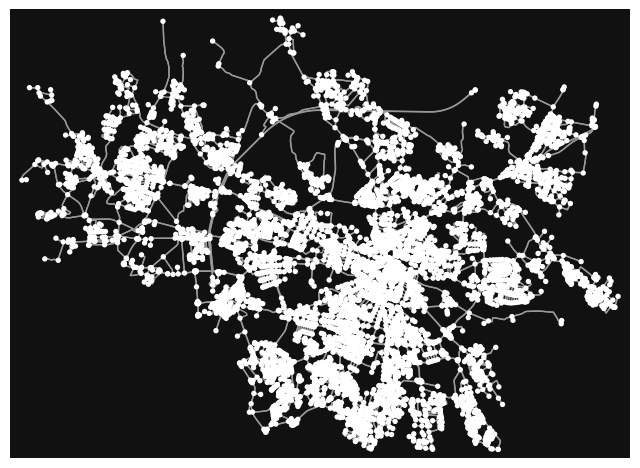

(<Figure size 800x800 with 1 Axes>, <Axes: >)

In [4]:
ox.plot_graph(G)

In [5]:
ox.plot_graph_folium(G, popup_attribute='name', weight=2, color='blue')

In [6]:
import folium
import networkx as nx
from shapely.geometry import LineString

In [7]:
import osmnx as ox
import folium
import networkx as nx
from shapely.geometry import LineString

# Load the graph (either from a file or downloaded)
G = ox.graph_from_place('Wrocław, Poland', network_type='drive')

# Create the map centered on Wrocław
m = ox.plot_graph_folium(G, popup_attribute='name', weight=2, color='blue')

# Let's find a path between two nodes (for example)
orig_node = list(G.nodes())[0]  # Replace with your specific origin node
dest_node = list(G.nodes())[-1]  # Replace with your specific destination node

# Find the shortest path (or any path algorithm)
route = nx.shortest_path(G, orig_node, dest_node, weight='length')

# Highlight the path with a different color (e.g., red)
for i in range(len(route) - 1):
    u, v = route[i], route[i + 1]
    edge_data = G.get_edge_data(u, v)
    # Ensure the edge has a geometry
    if 'geometry' in edge_data[0]:
        geometry = edge_data[0]['geometry']
        # Plot the path on the map with red color
        points = [(lat, lon) for lon, lat in geometry.coords]
        folium.PolyLine(points, color='red', weight=5, opacity=0.7).add_to(m)

# Display the map
m.save('highlighted_path_map.html')